## Objective:  
**Classifying the given Cotton Plant Or Cotton Leaf is Diseased Or Fresh.**  
The financial impacts of agriculture is increasing day by day with the economic growth of our country, still agriculture is one wide sector and that play a vital role for our country. While keeping track of diseases in plants with the help of specialists can be very costly in agriculture region.  
Hence, there is a need for a system which can automatically detect the diseases as it can bring revolution in monitoring large fields of crop and then plant leaves can be taken cure as soon as possible after detection of disease.


![](https://cdn.pixabay.com/photo/2019/11/26/12/54/cotton-4654533_1280.jpg)

## Setup

In [2]:
# Connect to google drive
from google.colab import drive
drive.mount('/content/gdrive')


Mounted at /content/gdrive


In [ ]:
# Now upload the file "kaggle.json" file
from google.colab import files
files.upload()   # Upload kaggle.json file contains your username and key

In [9]:
# Install kaggle package
!pip install --upgrade --force-reinstall --no-deps kaggle

# Ensure kaggle.json is in the location ~/.kaggle/kaggle.json to use the API.
!mkdir -p ~/.kaggle
!mv kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json  # set permission


     |█████▋                          | 10 kB 30.7 MB/s eta 0:00:01
     |███████████▏                    | 20 kB 24.3 MB/s eta 0:00:01
     |████████████████▊               | 30 kB 16.9 MB/s eta 0:00:01
     |██████████████████████▎         | 40 kB 15.0 MB/s eta 0:00:01
     |███████████████████████████▉    | 51 kB 5.3 MB/s eta 0:00:01
     |████████████████████████████████| 58 kB 3.1 MB/s 
  Created wheel for kaggle: filename=kaggle-1.5.12-py3-none-any.whl size=73051 sha256=9c79078f9ffcece7a78c46d9771e682ab64ada34bcf97a341ba81ded516057ac
  Stored in directory: /root/.cache/pip/wheels/62/d6/58/5853130f941e75b2177d281eb7e44b4a98ed46dd155f556dc5
Successfully built kaggle
  Attempting uninstall: kaggle
    Found existing installation: kaggle 1.5.12
    Uninstalling kaggle-1.5.12:
      Successfully uninstalled kaggle-1.5.12


In [10]:
# Required to save models in HDF5 format
!pip install pyyaml h5py  

In [19]:
# Load the TensorBoard notebook extension
%load_ext tensorboard

In [20]:
# Clear any logs from previous runs
!rm -rf ./logs/ 

In [21]:
# import libraries
import os
import cv2
import glob
import random
import datetime
import numpy as np
import pandas as pd
import seaborn as sns
from PIL import  Image
import tensorflow as tf
from google.colab import files
import matplotlib.pyplot as plt
from sklearn.metrics import accuracy_score
from tensorflow.keras import layers, models
from sklearn.metrics import confusion_matrix
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing import image
from tensorflow.keras.callbacks import TensorBoard
from tensorflow.keras.preprocessing.image import load_img
from tensorflow.keras.preprocessing.image import ImageDataGenerator

In [11]:
# plot func for later use

# plot accuracy loss
def plot_acc_loss(history):
  # summarize history for accuracy
  plt.plot(history.history['accuracy'])
  plt.plot(history.history['val_accuracy'])
  plt.title('model accuracy')
  plt.ylabel('accuracy')
  plt.xlabel('epoch')
  plt.legend(['train', 'test'], loc='upper left')
  plt.show()
  # summarize history for loss
  plt.plot(history.history['loss'])
  plt.plot(history.history['val_loss'])
  plt.title('model loss')
  plt.ylabel('loss')
  plt.xlabel('epoch')
  plt.legend(['train', 'test'], loc='upper left')
  plt.show()

# plot agumented images function
def plot_agumented_Images(images_arr):
    fig, axes = plt.subplots(1, 5, figsize=(20, 20))
    axes = axes.flatten()
    for img, ax in zip(images_arr, axes):
        ax.imshow(img)
    plt.tight_layout()
    plt.show()

# display the first 9 images of each type of train set func
def display_images(image_link):
  link_to_image = glob.glob(os.path.join(image_link+"/*"))
  images_ = link_to_image[:9]
  plt.figure(figsize=(20,25))
  for i, k in enumerate(images_):
    img = Image.open(k)
    plt.subplot(3,3,i+1)
    plt.imshow(img)
    plt.title(str(image_link).split('/')[-1])

# display random 9 images
def random_display_images(image_link):
  link_to_image = glob.glob(os.path.join(image_link+"/*"))
  images_ = random.choices(population=link_to_image,k= 9)
  plt.figure(figsize=(20,25))
  for i, k in enumerate(images_):
    img = Image.open(k)
    plt.subplot(3,3,i+1)
    plt.imshow(img)
    plt.title(str(image_link).split('/')[-1])

# make prediction function 
def predict_test_image(image_location):
  test_image=image.load_img(image_location, target_size = (224,224))
  plt.imshow(test_image)
  test_image=image.img_to_array(test_image)
  test_image=test_image/255
  test_image = np.expand_dims(test_image, axis = 0)
  preds=np.argmax(model.predict(test_image))
  if preds==0:
    print("The leaf is diseased cotton leaf")
  elif preds==1:
    print("The leaf is diseased cotton plant")
  elif preds==2:
    print("The leaf is fresh cotton leaf")
  else:
    print("The leaf is fresh cotton plant")

## Get and Explore data

### Get data

In [12]:
# Get data
!kaggle datasets download -d janmejaybhoi/cotton-disease-dataset

 87% 128M/148M [00:01<00:00, 113MB/s]
100% 148M/148M [00:01<00:00, 105MB/s]


In [13]:
# Unzip file
!unzip -q /content/cotton-disease-dataset.zip -d /content/

In [14]:
# create links to datasets
base_dir = './Cotton Disease'

val_dir = os.path.join(base_dir, 'val')
test_dir = os.path.join(base_dir, 'test')
train_dir = os.path.join(base_dir, 'train')

test_dis_leaf_dir = os.path.join(test_dir, 'diseased cotton leaf')
test_dis_plant_dir = os.path.join(test_dir, 'diseased cotton plant')
test_fresh_leaf_dir = os.path.join(test_dir, 'fresh cotton leaf')
test_fresh_plant_dir = os.path.join(test_dir, 'fresh cotton plant')

train_dis_leaf_dir = os.path.join(train_dir, 'diseased cotton leaf')
train_dis_plant_dir = os.path.join(train_dir, 'diseased cotton plant')
train_fresh_leaf_dir = os.path.join(train_dir, 'fresh cotton leaf')
train_fresh_plant_dir = os.path.join(train_dir, 'fresh cotton plant')

val_dis_leaf_dir = os.path.join(val_dir, 'diseased cotton leaf')
val_dis_plant_dir = os.path.join(val_dir, 'diseased cotton plant')
val_fresh_leaf_dir = os.path.join(val_dir, 'fresh cotton leaf')
val_fresh_plant_dir = os.path.join(val_dir, 'fresh cotton plant')

print(train_dis_leaf_dir, train_dis_plant_dir,'\n', train_fresh_leaf_dir, train_fresh_plant_dir )
print("_ _"*20) 
print(val_dis_leaf_dir, val_dis_plant_dir,'\n', val_fresh_leaf_dir, val_fresh_plant_dir )
print("_ _"*20)
print(test_dis_leaf_dir, test_dis_plant_dir,'\n', test_fresh_leaf_dir, test_fresh_plant_dir )

./Cotton Disease/train/diseased cotton leaf ./Cotton Disease/train/diseased cotton plant 
 ./Cotton Disease/train/fresh cotton leaf ./Cotton Disease/train/fresh cotton plant
_ __ __ __ __ __ __ __ __ __ __ __ __ __ __ __ __ __ __ __ _
./Cotton Disease/val/diseased cotton leaf ./Cotton Disease/val/diseased cotton plant 
 ./Cotton Disease/val/fresh cotton leaf ./Cotton Disease/val/fresh cotton plant
_ __ __ __ __ __ __ __ __ __ __ __ __ __ __ __ __ __ __ __ _
./Cotton Disease/test/diseased cotton leaf ./Cotton Disease/test/diseased cotton plant 
 ./Cotton Disease/test/fresh cotton leaf ./Cotton Disease/test/fresh cotton plant


### Explore data

In [ ]:
# display the first ten images of train set
train_dis_leaf_fnames = os.listdir(train_dis_leaf_dir)
train_dis_plant_fnames = os.listdir(train_dis_plant_dir)
print(train_dis_leaf_fnames[:10])
print(train_dis_plant_fnames[:10])

['dis_leaf (167)_iaip.jpg', 'dis_leaf (293)_iaip.jpg', 'dis_leaf (169)_iaip.jpg', 'dis_leaf (339)_iaip.jpg', 'dis_leaf (184)_iaip.jpg', 'dis_leaf (5)_iaip.jpg', 'dis_leaf (304)_iaip.jpg', 'dis_leaf (22)_iaip.jpg', 'dis_leaf (3)_iaip.jpg', 'dis_leaf (178)_iaip.jpg']
['dd (35)_iaip.jpg', 'dd (498)_iaip.jpg', 'dd (464)_iaip.jpg', 'dd (32)_iaip.jpg', 'dd (484)_iaip.jpg', 'dd (420)_iaip.jpg', 'dd (228)_iaip.jpg', 'dd (222)_iaip.jpg', 'dd (178)_iaip.jpg', 'dd (403)_iaip.jpg']


In [10]:
# Count the number of images of each data set
train = list(( len(os.listdir(train_dis_leaf_dir)),len(os.listdir(train_dis_plant_dir)), 
               len(os.listdir(train_fresh_leaf_dir)), len(os.listdir(train_fresh_plant_dir))
               ))
val = list((  len(os.listdir(val_dis_leaf_dir)),len(os.listdir(val_dis_plant_dir)), 
               len(os.listdir(val_fresh_leaf_dir)), len(os.listdir(val_fresh_plant_dir))
            ))
test = list((  len(os.listdir(test_dis_leaf_dir)),len(os.listdir(test_dis_plant_dir)), 
               len(os.listdir(test_fresh_leaf_dir)), len(os.listdir(test_fresh_plant_dir))
            ))
characteristics = ['diseased cotton leaf','diseased cotton plant','fresh cotton leaf','fresh cotton plant']
dict_ = {'Char':characteristics,'Train':train, 'Val':val, 'Test':test}
df = pd.DataFrame(dict_, columns=['Char','Train','Val','Test'])
print("Table: The number of images of each chars")
df

Table: The number of images of each chars


,Char,Train,Val,Test
0,diseased cotton leaf,288,43,25
1,diseased cotton plant,815,78,28
2,fresh cotton leaf,427,66,26
3,fresh cotton plant,421,66,27


None
None
None
None


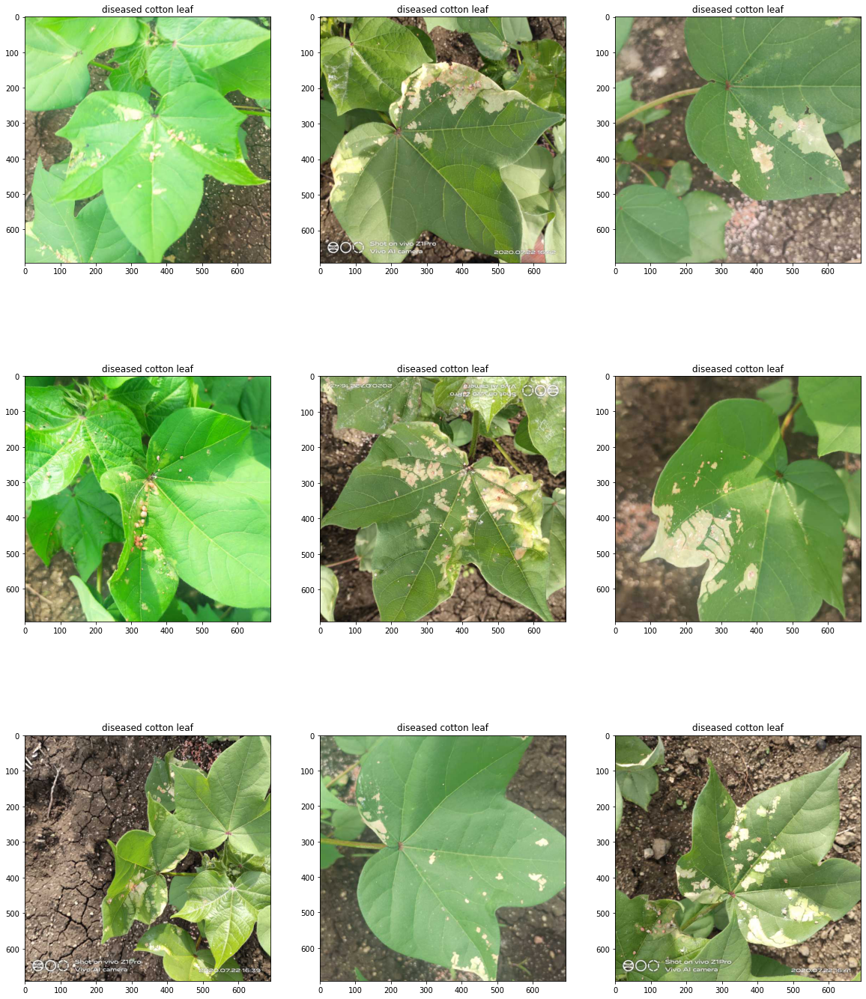

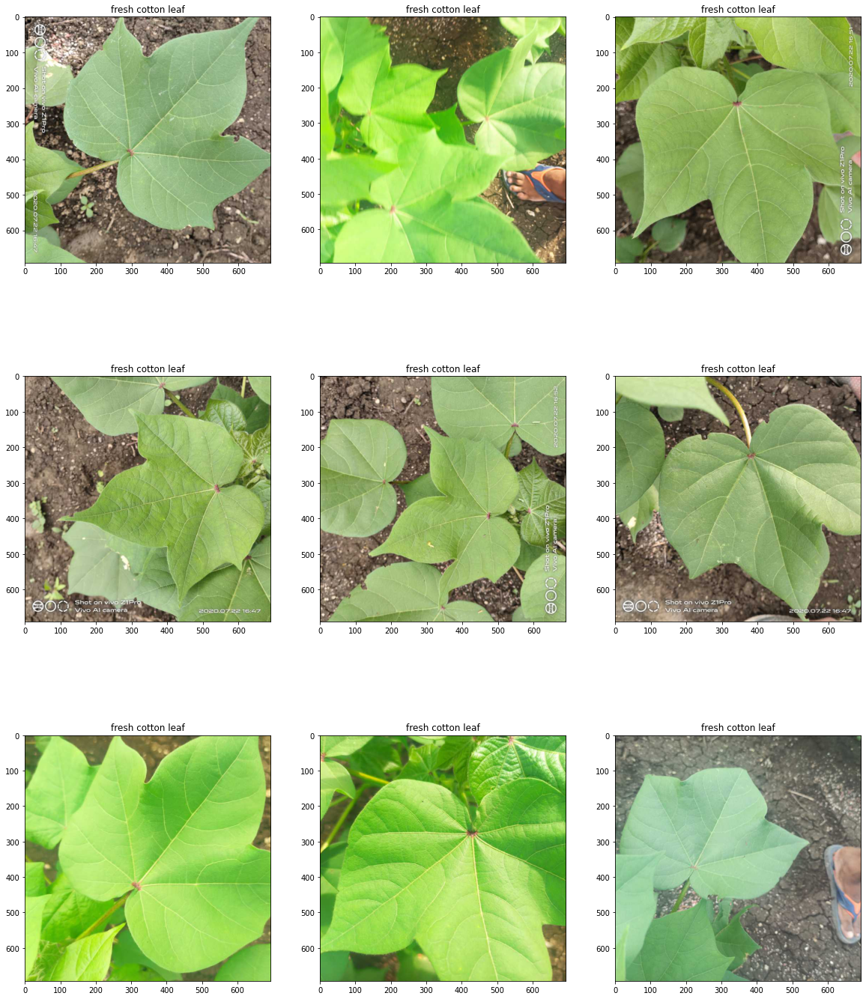

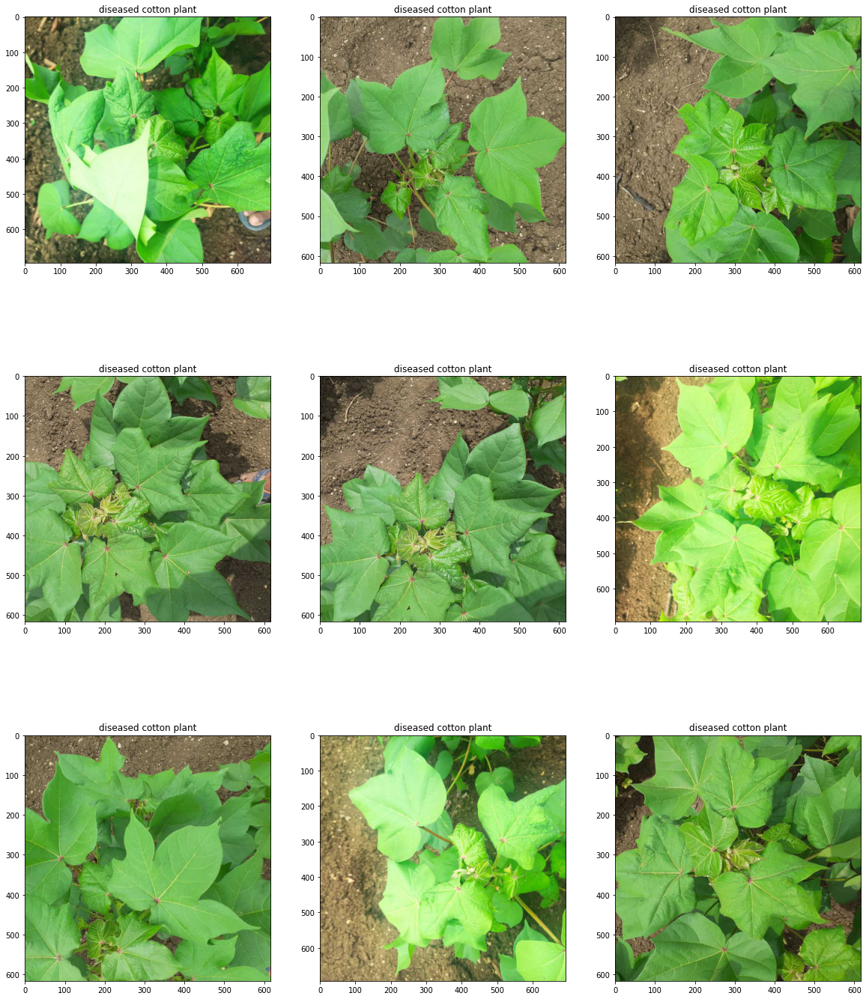

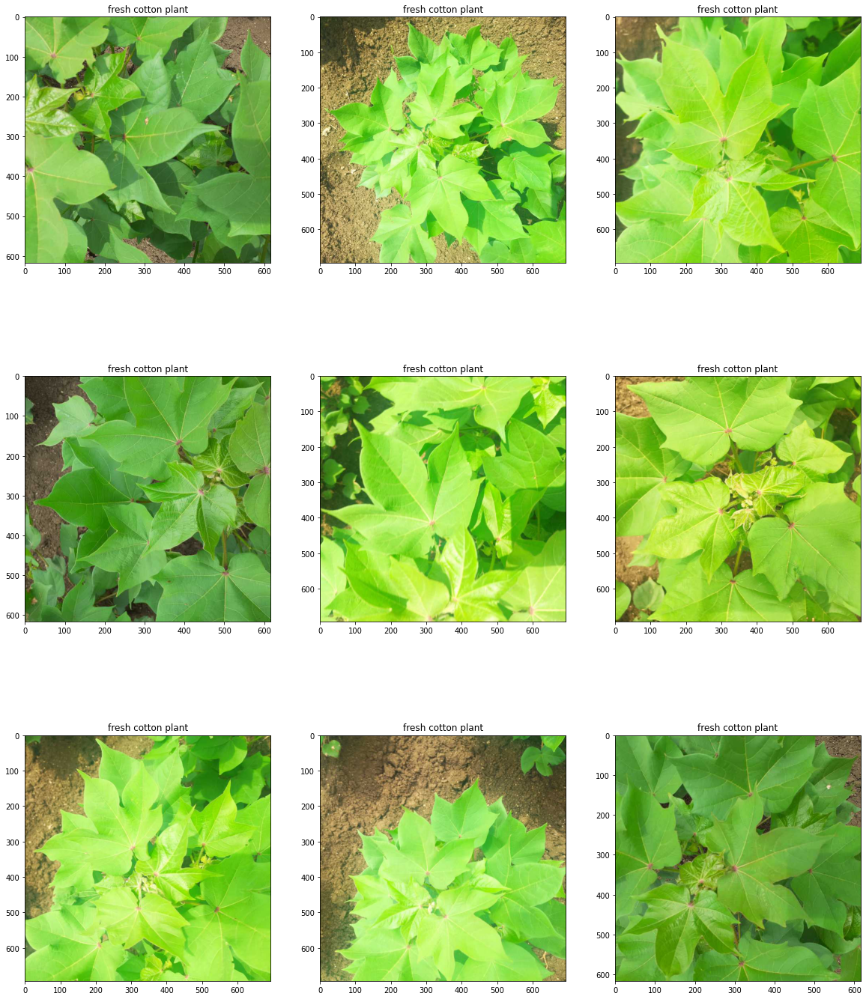

In [47]:
# display randomly the first 9 images of each type of train set
print(random_display_images(train_dis_leaf_dir))
print(random_display_images(train_fresh_leaf_dir))
print(random_display_images(train_dis_plant_dir))
print(random_display_images(train_fresh_plant_dir))

## Data Agumentation

In [15]:
# data agumentation
train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=40,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest')

train_agumented = train_datagen.flow_from_directory(
    train_dir, target_size = (224, 224),
    batch_size = 32 ,class_mode = 'categorical')

val_datagen = ImageDataGenerator(rescale=1./255)
val_agumented = val_datagen.flow_from_directory(
    val_dir, target_size = (224, 224),
    batch_size = 32, class_mode = 'categorical')

Found 1951 images belonging to 4 classes.
Found 253 images belonging to 4 classes.


In [ ]:
# display 4 classes of each data set
print('There are 4 classes:',train_agumented.class_indices )

There are 4 classes: {'diseased cotton leaf': 0, 'diseased cotton plant': 1, 'fresh cotton leaf': 2, 'fresh cotton plant': 3}


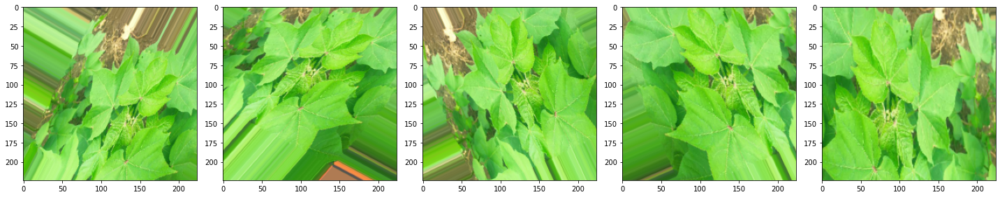

In [ ]:
# display 5 agumented images
images = [train_agumented[0][0][0] for i in range(5)]
plot_agumented_Images(images)

## Model

- CNN - 32 filters, kernel size 3x3, activation relu, with input shape = 224x224x3
- Max Pooling with kernel size 2x2
- CNN - 64 filters, kernel size 3x3, activation relu
- Max Pooling with kernel size 2x2
- CNN - 128 filters, kernel size 3x3, activation relu
- Max Pooling with kernel size 2x2
- CNN - 256 filters, kernel size 3x3, activation relu
- Max Pooling with kernel size 2x2  
- Dropout layer (dropout rate =0.5)
- Flatten the output of the cube output of the previous CNN layer
- Dense with 128 neurons with activation relu
- Dropout layer (dropout rate =0.1)
- Dense with 256 neurons with activation relu
- Dropout layer (dropout rate =0.25)
- Dense with 4 neurons with activation softmax

In [16]:
# build a model for training
model = models.Sequential([
            layers.Conv2D(32, (3,3), activation='relu',input_shape=(224,224,3)),
            layers.MaxPooling2D((2,2)),
            layers.Conv2D(64,(3,3), activation = 'relu'),
            layers.MaxPooling2D((2,2)),
            layers.Conv2D(128,(3,3), activation = 'relu'),
            layers.MaxPooling2D((2,2)),
            layers.Conv2D(256,(3,3), activation = 'relu'),
            layers.MaxPooling2D((2,2)),

            layers.Dropout(0.5),
            layers.Flatten(),
            layers.Dense(128, activation = 'relu'),
            layers.Dropout(0.1),
            layers.Dense(256, activation = 'relu'),
            layers.Dropout(0.25),
            layers.Dense(4, activation = 'softmax')
])
# configures the model for training
model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['accuracy'])

In [17]:
# summary
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 222, 222, 32)      896       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 111, 111, 32)      0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 109, 109, 64)      18496     
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 54, 54, 64)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 52, 52, 128)       73856     
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 26, 26, 128)       0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 24, 24, 256)       2

In [26]:
# trains the model
%%time
log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = TensorBoard(log_dir=log_dir, histogram_freq=1)
history = model.fit(train_agumented,
                    validation_data= val_agumented,
                    epochs=40, verbose=2,callbacks=[tensorboard_callback]) # already run 5 epochs        

Epoch 1/40
61/61 - 36s - loss: 0.4047 - accuracy: 0.8426 - val_loss: 0.2885 - val_accuracy: 0.8814
Epoch 2/40
61/61 - 35s - loss: 0.3866 - accuracy: 0.8432 - val_loss: 0.3220 - val_accuracy: 0.8577
Epoch 3/40
61/61 - 35s - loss: 0.3478 - accuracy: 0.8570 - val_loss: 0.4691 - val_accuracy: 0.8182
Epoch 4/40
61/61 - 35s - loss: 0.3493 - accuracy: 0.8539 - val_loss: 0.1764 - val_accuracy: 0.9328
Epoch 5/40
61/61 - 35s - loss: 0.3513 - accuracy: 0.8611 - val_loss: 0.2241 - val_accuracy: 0.8893
Epoch 6/40
61/61 - 35s - loss: 0.3595 - accuracy: 0.8539 - val_loss: 0.1837 - val_accuracy: 0.9289
Epoch 7/40
61/61 - 36s - loss: 0.2971 - accuracy: 0.8816 - val_loss: 0.1507 - val_accuracy: 0.9407
Epoch 8/40
61/61 - 36s - loss: 0.2950 - accuracy: 0.8888 - val_loss: 0.1581 - val_accuracy: 0.9565
Epoch 9/40
61/61 - 35s - loss: 0.3728 - accuracy: 0.8462 - val_loss: 0.1670 - val_accuracy: 0.9407
Epoch 10/40
61/61 - 35s - loss: 0.3114 - accuracy: 0.8790 - val_loss: 0.1307 - val_accuracy: 0.9447
Epoch 11/

In [27]:
# evalute the model
val_loss, val_acc = model.evaluate(val_agumented)
print("Validation Accuracy: {:5.2f}%".format(val_acc*100))

8/8 [==============================] - 2s 263ms/step - loss: 0.1137 - accuracy: 0.9605
Validation Accuracy: 96.05%


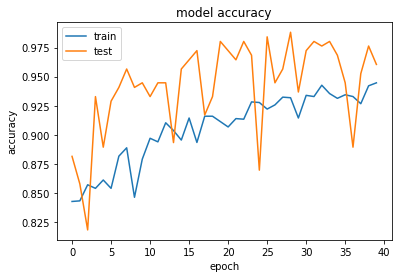

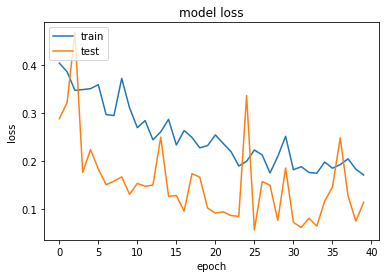

In [28]:
# plot accuracy and loss charts
plot_acc_loss(history)

In [17]:
# save model
!mkdir -p /content/gdrive/MyDrive/Cotton Disease/result
model.save('/content/gdrive/MyDrive/Cotton Disease/result/Cotton')

INFO:tensorflow:Assets written to: /content/gdrive/MyDrive/Cotton Disease/result/Cotton/assets


In [5]:
# load new model
new_model = tf.keras.models.load_model('/content/gdrive/MyDrive/Cotton Disease/result/Cotton')
new_model

In [6]:
new_model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 222, 222, 32)      896       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 111, 111, 32)      0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 109, 109, 64)      18496     
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 54, 54, 64)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 52, 52, 128)       73856     
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 26, 26, 128)       0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 24, 24, 256)       2

In [24]:
# evalute the model
val_loss, val_acc = new_model.evaluate(val_agumented)
print("Validation Accuracy: {:5.2f}%".format(val_acc*100))

8/8 [==============================] - 2s 238ms/step - loss: 0.0950 - accuracy: 0.9644
Validation Accuracy: 96.44%


## Prediction

In [29]:
# Upload a photo from your folder and predict
uploaded = files.upload()
for fn in uploaded.keys():
  print(fn)
  image_location = './' + fn

Saving d (40)_iaip - Copy.jpg to d (40)_iaip - Copy.jpg
d (40)_iaip - Copy.jpg


The leaf is fresh cotton leaf


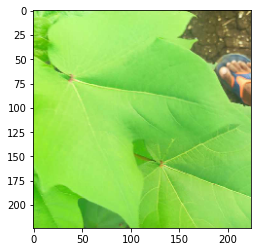

In [30]:
# dont believe, just watch 
predict_test_image(image_location)

The leaf is fresh cotton leaf


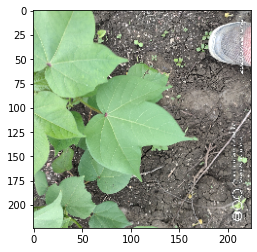

In [31]:
predict_test_image('/content/Cotton Disease/test/fresh cotton leaf/d (384).jpg')

The leaf is fresh cotton plant


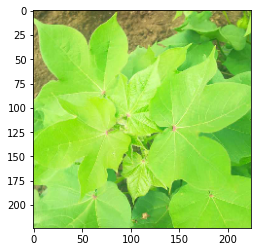

In [32]:
predict_test_image('/content/Cotton Disease/test/fresh cotton plant/dsd (518)_iaip.jpg')

The leaf is diseased cotton leaf


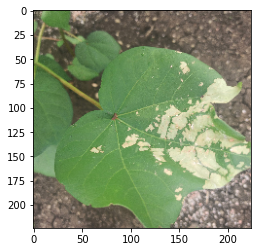

In [33]:
# or input link from google colab and predict
predict_test_image('/content/Cotton Disease/test/diseased cotton leaf/dis_leaf (124).jpg')

The leaf is diseased cotton plant


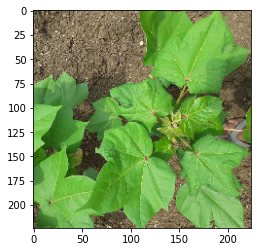

In [34]:
predict_test_image('/content/Cotton Disease/test/diseased cotton plant/dd (16)_iaip.jpg')

The leaf is diseased cotton plant


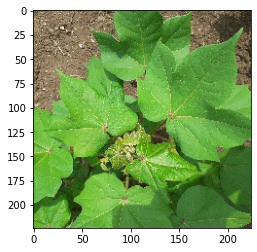

In [35]:
predict_test_image('/content/Cotton Disease/test/diseased cotton plant/dd (367).jpg')

The leaf is diseased cotton plant


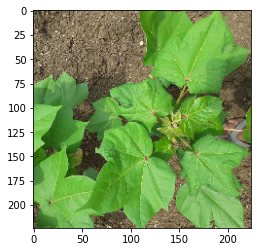

In [36]:
predict_test_image('/content/Cotton Disease/test/diseased cotton plant/dd (16)_iaip.jpg')

### Confusion matrix

In [38]:
# resize images
test_datagen = ImageDataGenerator(rescale=1./255)
test_agumented = test_datagen.flow_from_directory(
    test_dir, target_size = (224, 224),
    batch_size = 32, class_mode = 'categorical')
# predict test set
predicted= model.predict(test_agumented[0][0])

Found 106 images belonging to 4 classes.


In [39]:
# create actual, predict lists
actual=[]
for i in test_agumented[0][1]:
  actual.append(np.argmax(i))
predict=[]
for i in predicted:
  predict.append(np.argmax(i))
# evaluate
accuracy_score(actual,predict)

0.90625

[]

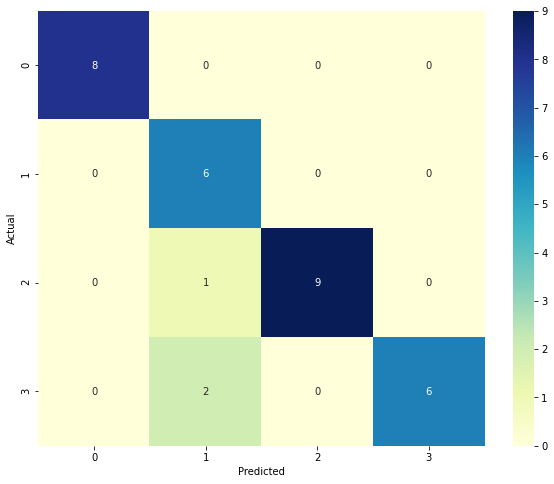

In [40]:
# confusion matrix
confusion_mtx = confusion_matrix(actual,predict) 
plt.figure(figsize=(10,8))
sns.heatmap(confusion_mtx,annot=True,annot_kws={"size": 10} , cmap="YlGnBu")
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.plot()

## Extra test

In [25]:
# build a model for training without drop out layers
model_1 = models.Sequential([
            layers.Conv2D(32, (3,3), activation='relu',input_shape=(224,224,3)),
            layers.MaxPooling2D((2,2)),
            layers.Conv2D(64,(3,3), activation = 'relu'),
            layers.MaxPooling2D((2,2)),
            layers.Conv2D(128,(3,3), activation = 'relu'),
            layers.MaxPooling2D((2,2)),
            layers.Conv2D(256,(3,3), activation = 'relu'),
            layers.MaxPooling2D((2,2)),
            layers.Flatten(),
            layers.Dense(128, activation = 'relu'),
            layers.Dense(256, activation = 'relu'),
            layers.Dense(4, activation = 'softmax')
])
# configures the model for training
model_1.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['accuracy'])

In [ ]:
model_1.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_8 (Conv2D)            (None, 222, 222, 32)      896       
_________________________________________________________________
max_pooling2d_8 (MaxPooling2 (None, 111, 111, 32)      0         
_________________________________________________________________
conv2d_9 (Conv2D)            (None, 109, 109, 64)      18496     
_________________________________________________________________
max_pooling2d_9 (MaxPooling2 (None, 54, 54, 64)        0         
_________________________________________________________________
conv2d_10 (Conv2D)           (None, 52, 52, 128)       73856     
_________________________________________________________________
max_pooling2d_10 (MaxPooling (None, 26, 26, 128)       0         
_________________________________________________________________
conv2d_11 (Conv2D)           (None, 24, 24, 256)      

In [ ]:
from tensorflow.keras.callbacks import EarlyStopping
earlystopping_callback =  EarlyStopping(
    monitor='val_loss',
    min_delta=1e-2, # "improving" threshold
    patience=10, restore_best_weights= True,
    verbose=1)

In [ ]:
history = model_1.fit(train_agumented,
                    validation_data= val_agumented,
                    epochs=50, verbose=2, 
                    callbacks=[earlystopping_callback]
)

Epoch 1/50
61/61 - 39s - loss: 1.1467 - accuracy: 0.4987 - val_loss: 1.0569 - val_accuracy: 0.4822
Epoch 2/50
61/61 - 38s - loss: 1.0177 - accuracy: 0.5864 - val_loss: 1.0657 - val_accuracy: 0.4506
Epoch 3/50
61/61 - 38s - loss: 0.9715 - accuracy: 0.5992 - val_loss: 0.9347 - val_accuracy: 0.6324
Epoch 4/50
61/61 - 34s - loss: 0.8214 - accuracy: 0.6750 - val_loss: 0.6732 - val_accuracy: 0.7273
Epoch 5/50
61/61 - 38s - loss: 0.6941 - accuracy: 0.7309 - val_loss: 0.4861 - val_accuracy: 0.8103
Epoch 6/50
61/61 - 38s - loss: 0.6002 - accuracy: 0.7668 - val_loss: 0.4132 - val_accuracy: 0.8103
Epoch 7/50
61/61 - 38s - loss: 0.4848 - accuracy: 0.8037 - val_loss: 0.3654 - val_accuracy: 0.8735
Epoch 8/50
61/61 - 37s - loss: 0.4097 - accuracy: 0.8447 - val_loss: 0.2482 - val_accuracy: 0.9130
Epoch 9/50
61/61 - 37s - loss: 0.3971 - accuracy: 0.8452 - val_loss: 0.2690 - val_accuracy: 0.9012
Epoch 10/50
61/61 - 37s - loss: 0.3890 - accuracy: 0.8493 - val_loss: 0.2785 - val_accuracy: 0.9012
Epoch 11/

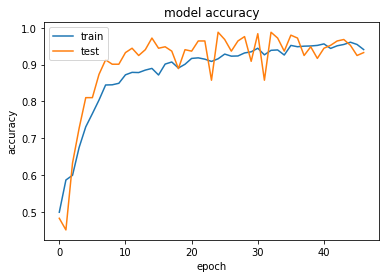

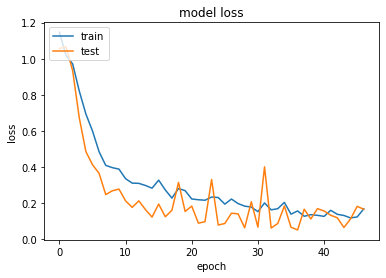

In [ ]:
# plot accuracy and loss charts
plot_acc_loss(history)

In [ ]:
def predict_test_image(image_location):
  test_image=image.load_img(image_location, target_size = (224,224))
  plt.imshow(test_image)
  test_image=image.img_to_array(test_image)
  test_image=test_image/255
  test_image = np.expand_dims(test_image, axis = 0)
  preds=np.argmax(model_1.predict(test_image))
  if preds==0:
    print("The leaf is diseased cotton leaf")
  elif preds==1:
    print("The leaf is diseased cotton plant")
  elif preds==2:
    print("The leaf is fresh cotton leaf")
  else:
    print("The leaf is fresh cotton plant")

The leaf is diseased cotton plant


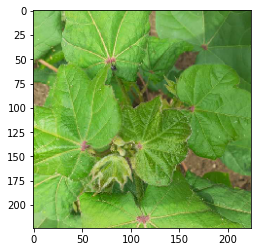

In [ ]:
predict_test_image('/content/Cotton Disease/test/diseased cotton plant/dd (895)_iaip.jpg')

The leaf is diseased cotton plant


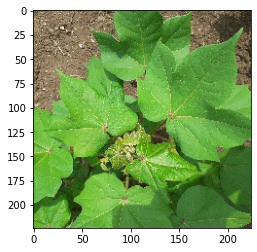

In [ ]:
predict_test_image('/content/Cotton Disease/test/diseased cotton plant/dd (367).jpg')

The leaf is diseased cotton plant


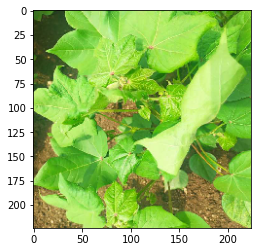

In [ ]:
predict_test_image('/content/Cotton Disease/test/diseased cotton plant/dd (759)_iaip.jpg')

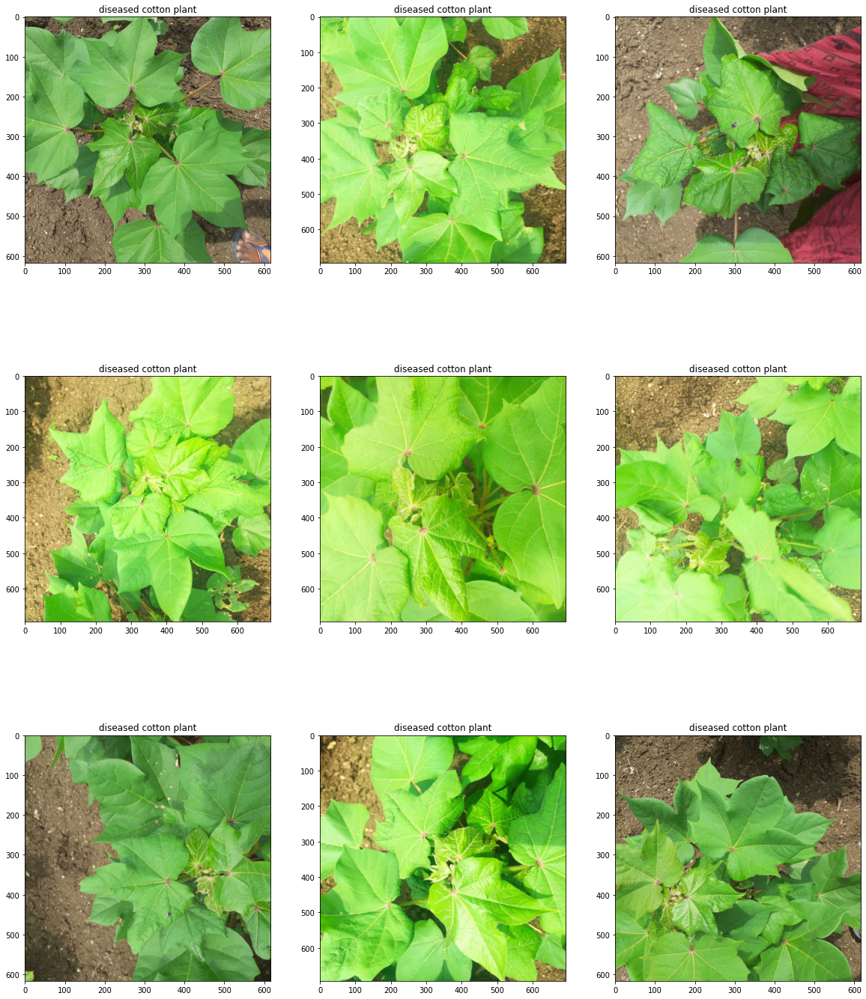

In [ ]:
link_to_image = glob.glob(os.path.join(train_dis_plant_dir+"/*"))
images_ = random.choices(population=link_to_image,k= 9)
plt.figure(figsize=(20,25))
for i, k in enumerate(images_):
  img = Image.open(k)
  plt.subplot(3,3,i+1)
  plt.imshow(img)
  plt.title(str(train_dis_plant_dir).split('/')[-1])

## TensorBoard

In [37]:
%tensorboard --logdir logs/fit

Reusing TensorBoard on port 6006 (pid 751), started 0:34:17 ago. (Use '!kill 751' to kill it.)

<IPython.core.display.Javascript object>